In [2]:
#!pip install -r requirements.txt

In [3]:
%load_ext autoreload
%autoreload 2

from IPython.core.display import display, HTML
display(HTML("<style>.container { width:100% !important; }</style>"))

import warnings
warnings.filterwarnings('ignore')

import os
import pandas as pd
import numpy as np
from tqdm.notebook import tqdm

pd.options.plotting.backend = "plotly"
import seaborn as sns
from plotly.subplots import make_subplots
import plotly.graph_objects as go
import matplotlib.pyplot as plt
plt.rcParams["figure.figsize"] = (20,10)
import plotly_express as px
import plotly.figure_factory as ff
from IPython.display import Image

from src.wk_means import WKMeans
from hmmlearn.hmm import GaussianHMM
from sklearn.cluster import KMeans
from sklearn.metrics import v_measure_score
from scipy.stats import moment
from src.clustering_utils import *

In this notebook, the goal is to **explore and compare** different Regime Change Detection (clustering) methods on data generated from a Merton Jump Diffusion Process.

We will test the following methods :
1. Wasserstein k-means

2. Moments k-means

3. Hidden Markov Model

# 0. Generate Data from Merton Jump Diffusion process

## 0.1 Path parameters


MJD is a stochastic process defined by the following SDE:

$$
d S_{t}=\mu S_{t} d t+\sigma S_{t} d W_{t}+S_{t-} d J_{t} \quad \text { for } t \geq 0
$$

where
$$
J_{t}=\sum_{j=1}^{N_{t}} V_{j}-1
$$
$N_{t} \sim \operatorname{Po}(\lambda t)$ is a Poisson random variable, and $\ln \left(1+V_{j}\right) \sim \operatorname{Normal}\left(\gamma, \delta^{2}\right)$

So, we can define MJD using the following paramters : 

* μ = Drift
* σ = Volatility

* λ = Number of jumps per year (intensity)
* γ = mean of Jump Size
* δ = Standard Deviation of Jump Size


In this notebook, we will generate a MJD with two regimes. Practically, we define the number of regime changes r ∈ N we wish to observe. We specify their starting points and lengths.

* 20 years
* hourly data
* two regimes :
    - bullish
    - bearish

The bearish regime would last ** 6 months ** and we would have 10 regime changes.




In [4]:
prng = np.random.RandomState(42)

regime_duration = 0.5*252*7 # 6months

params = {'prng' : prng,  
          'T':20, #20 years
          'steps':20*252*7, #hourly data 
          
           #bullish regime
          'mu_1':0.05,         
          'sigma_1':0.2,
          'lam_1':5,
          'gamma_1':0.02,
          'delta_1':0.0125,
          
           #bearish regime
          'mu_2':-0.05,         
          'sigma_2':0.4,
          'lam_2':10,
          'gamma_2':-0.04,
          'delta_2':0.1,
          
           
          'regime_duration':regime_duration,
          'n_regime_changes':10 
         }

index_data, regime_dates = merton_jump_paths(**params)
index_data = pd.Series(index_data.flatten(), name='index_data')

In [5]:
fig = index_data.plot()

for d in regime_dates:
    fig.add_vrect(x0=d, x1=d+regime_duration)
fig.update_layout(xaxis_title='date',
                  yaxis_title = 'raw',)
fig.show()

fig = index_data.apply(np.log).diff().plot()
for d in regime_dates:
    fig.add_vrect(x0=d, x1=d+regime_duration)
fig.update_layout(xaxis_title='date',
                  yaxis_title='log returns',)
fig.show()

Next, we generate our groun truth data that will serve as benchmark.

In [6]:
y_truth = np.zeros(len(index_data))
for d in regime_dates:
    y_truth[d:d+int(regime_duration)] = 1

y_truth = pd.Series(y_truth, index=index_data.index, name='y_truth')

In [7]:
fig = y_truth.plot()
fig.update_layout(xaxis_title='date',
                  yaxis_title='y_truth',)


# 1. Prepare different estimators

Now that we have the raw generated data, we can proceed to prepare features for each model. 

# 1.1 WK means

To use the WK-means, we need to define the features and the model.
We will take an observation window of one week (35 hourly returns) with a step of 1 day (7 hourly returns) :

* First oberservation : observation at $t_{42}$ : [$R (t_{6}, t_{7}) , R (t_{7}, t_{8}) ....... R (t_{40}, t_{41}) $]
* Second oberservation : observation at $t_{49}$ : [$R (t_{13}, t_{14}) , R (t_{14}, t_{15}) ....... R (t_{47}, t_{48}) $]
* ........................

From each each observation window, we will compute the features : 
* features at $t_{42}$ : sort([$R (t_{6}, t_{7}) , R (t_{7}, t_{8}) ....... R (t_{40}, t_{41}) $]) = atoms of the empirical measure
* features at $t_{48}$ : sort([$R (t_{13}, t_{14}) , R (t_{14}, t_{15}) ....... R (t_{47}, t_{48}) $]) = atoms of the empirical measure
* ........................

### A bit of theory :

Each observation represents a distribution. 
An emprical measure of a distributin is defined as :
$$
\mu^{r}((-\infty, x])=\frac{1}{N} \sum_{i=1}^{N} \chi_{\left\{Q^{i}(r) \leq x\right)}(x),
$$

where $\chi: \mathbb{R} \rightarrow[0,1]$ is the indicator function and $Q^{j}: \mathcal{S}(\mathbb{R}) \rightarrow \mathbb{R}$ is j_th order stat for j in 1..N.

<hr />

The Wasserstein distance between two empirical measures is defined as :

$$
\mathcal{W}_{p}(\mu, \nu):=\min _{\mathbb{P} \in \Pi(\mu, \nu)}\left\{\int_{X \times X} d(x, y)^{p} \mathbb{P}(d x, d y)\right\},
$$

where
$\Pi(\mu, \nu):=\{\mathbb{P} \in \mathcal{P}(X \times X): \mathbb{P}(A \times X)=\mu(A), \quad \mathbb{P}(X \times B)=\nu(B)\}
$ is the set of transport plans between $\mu$ and $\nu$.

and
$$
d(x,y) = ||x-y||_X
$$

You can see it as the minimum "cost" of turning one distribution into the other.
<hr />

However, we can compute the W distance between two emprical measures using this simplification :

$$
\mu((-\infty, x])=\frac{1}{N} \sum_{i=1}^{N} \chi_{\alpha_{i} \leq x}(x), \quad \nu((-\infty, x])=\frac{1}{N} \sum_{i=1}^{N} \chi_{\beta_{i} \leq x}(x)
$$
where $\left(\alpha_{i}\right)_{1 \leq i \leq N}$ and $\left(\beta_{i}\right)_{1 \leq i \leq N}$ are increasing sequences corresponding to the atoms of $\mu$ and $\nu$. (cf $\frac{1}{N} \sum_{i=1}^{N} \chi_{\left\{Q^{i}(r) \leq x\right)}(x)$)

$$
\begin{aligned}
\mathcal{W}_{p}(\mu, \nu)^{p}
&=\frac{1}{N} \sum_{i=1}^{N}\left|\alpha_{i}-\beta_{i}\right|^{p}
\end{aligned}
$$

<hr />

When p=1, the Wassertstein distance is equivalent to the Earth Mover's Distance. 

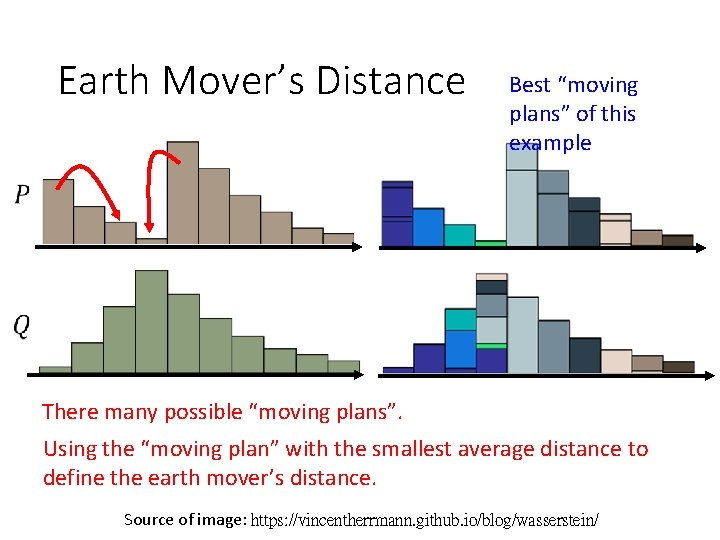

In [8]:
Image(filename='src/EMD.jpg')

In [9]:
h1 = 35 #stride
h2 = 7 #step

stream = index_data.apply(np.log).diff().ffill().dropna()
features_wk_means, lift = partition(stream, h1, h2, return_lift=True)

In [10]:
features_wk_means

,alpha_1,alpha_2,alpha_3,alpha_4,alpha_5,alpha_6,alpha_7,alpha_8,alpha_9,alpha_10,...,alpha_26,alpha_27,alpha_28,alpha_29,alpha_30,alpha_31,alpha_32,alpha_33,alpha_34,alpha_35
42,-0.007579,-0.005853,-0.005736,-0.003112,-0.002429,-0.002100,-0.001600,-0.001512,-0.001430,-0.001417,...,0.003541,0.003874,0.004187,0.004924,0.004994,0.005197,0.005475,0.005644,0.006646,0.008780
49,-0.005736,-0.003112,-0.002437,-0.002429,-0.002100,-0.001781,-0.001600,-0.001512,-0.001430,-0.001417,...,0.003541,0.003874,0.004187,0.004356,0.004924,0.005197,0.005475,0.006551,0.006646,0.010391
56,-0.004169,-0.003112,-0.002437,-0.002429,-0.002100,-0.001781,-0.001600,-0.001574,-0.001430,-0.001417,...,0.003541,0.003683,0.003874,0.004356,0.004924,0.005475,0.006185,0.006551,0.006646,0.010391
63,-0.005834,-0.005423,-0.004169,-0.003442,-0.002437,-0.002100,-0.001781,-0.001600,-0.001574,-0.001430,...,0.003087,0.003541,0.003683,0.003995,0.004356,0.005475,0.006185,0.006551,0.006646,0.010391
70,-0.007253,-0.005834,-0.005423,-0.004169,-0.003925,-0.003442,-0.002437,-0.002100,-0.001781,-0.001574,...,0.003486,0.003541,0.003683,0.003995,0.004356,0.006185,0.006551,0.006646,0.006882,0.010391
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
35245,-0.010462,-0.009677,-0.006406,-0.005474,-0.004770,-0.004507,-0.003745,-0.003572,-0.003460,-0.002586,...,0.003868,0.004693,0.004768,0.005655,0.006248,0.007028,0.007319,0.008577,0.008605,0.009217
35252,-0.009677,-0.009025,-0.007934,-0.005474,-0.004770,-0.004507,-0.003745,-0.003572,-0.003460,-0.002586,...,0.002787,0.003868,0.004768,0.005076,0.005655,0.006248,0.007028,0.008577,0.008605,0.009217
35259,-0.009677,-0.009025,-0.007934,-0.004770,-0.004507,-0.004213,-0.003745,-0.003572,-0.003022,-0.002822,...,0.003200,0.003859,0.003868,0.004768,0.005076,0.005655,0.005762,0.008577,0.008605,0.009217
35266,-0.009677,-0.009025,-0.007934,-0.005809,-0.004507,-0.004213,-0.003745,-0.003572,-0.003022,-0.002822,...,0.003859,0.003868,0.004768,0.005076,0.005655,0.005762,0.008605,0.009180,0.009217,0.009399


Now we will initialize and fit a WK means model :

In [11]:
estimator_wk_means = WKMeans(n_clusters=2, random_state=2022)
estimator_wk_means.fit(features_wk_means)

WKMeans(random_state=2022)

In [12]:
labels_wk_means = create_labels(estimator_wk_means, features_wk_means)
labels_wk_means = labels_wk_means.replace(0,-1).replace(1,0).replace(-1,1) # we exchange 0 and 1 to be consistent with the ground truth

In [13]:
fig = plot_regime_time_series(labels_wk_means, index_data, return_fig=True)
for d in regime_dates:
    fig.add_vrect(x0=d, x1=d+regime_duration)
fig.show()

We compute the accuracy of the WK means :

In [14]:
(y_truth.loc[labels_wk_means.index] == labels_wk_means).mean()

0.9908621374652364

We compute the V-measure of the WK means :

 **v = (1 + beta) * homogeneity * completeness / (beta * homogeneity + completeness)**

* Completeness :
    A clustering result satisfies completeness if all the data points that are members of a given class are elements of the same cluster.

* homogeneity : 
    A clustering result satisfies homogeneity if all of its clusters contain only data points which are members of a single class.

In [15]:
v_measure_score(y_truth[labels_wk_means.index], labels_wk_means)

0.9027865146137531

To have another view on the clustering, we plot each set of returns in the mean/vol space :

In [16]:
# Here, the centroids are calculated as the Wasserstein barycenter of each cluster
# then, for each barycenter, we compute the mean and the std

mean_volatility_plot(lift,labels_wk_means, estimator_wk_means.cluster_centers_, np.array(estimator_wk_means.cluster_centers_).mean(axis=1),
                    np.array(estimator_wk_means.cluster_centers_).std(axis=1))

# 1.2 MK means

To use the MK-means, we need to define the features and the model.
We will take an observation window of one week (35 returns) with a step of 1 :

* First oberservation : observation at $t_{42}$ : [$R (t_{6}, t_{7}) , R (t_{7}, t_{8}) ....... R (t_{40}, t_{41}) $]
* Second oberservation : observation at $t_{49}$ : [$R (t_{13}, t_{14}) , R (t_{14}, t_{15}) ....... R (t_{47}, t_{48}) $]
* ........................

From each each observation window, we will compute the features : 
* features at $t_{42}$ : moments( [$R (t_{6}, t_{7}) , R (t_{7}, t_{8}) ....... R (t_{40}, t_{41}) $])
* features at $t_{49}$ : moments([$R (t_{13}, t_{14}) , R (t_{14}, t_{15}) ....... R (t_{47}, t_{48}) $])
* ........................

Then, on this features space, we apply the regular kmeans algorithm.
It is important to re-scale the moments, beacuse the moments value deacreases as the moment degree increases.

<hr />

In this example, we will limit ourselves to the first **two** moments.

In [17]:
h1 = 35 #stride
h2 = 7 #step

p = 2

stream = index_data.apply(np.log).diff().ffill().dropna()
_, lift = partition(stream, h1, h2, return_lift=True)

moments = pd.concat([lift.mean(axis=1).rename(f'moment_{1}')]+[lift.apply(lambda series : moment(series, moment=i), axis=1).rename(f'moment_{i}') for i in range(2,p+1)],
          axis = 1)

mean = moments.mean()
std = moments.std()

moments = (moments - moments.mean()) / (moments.std())

features_mk_means = moments

In [18]:
features_mk_means

,moment_1,moment_2
42,0.907713,-0.222289
49,1.189519,-0.234372
56,1.197691,-0.235915
63,0.838618,-0.224189
70,0.766691,-0.207983
...,...,...
35245,0.645321,-0.156106
35252,0.469622,-0.163878
35259,0.306663,-0.171253
35266,0.415906,-0.152926


Now we will initialize and fit a WK means model :

In [19]:
estimator_mk_means = KMeans(n_clusters=2, random_state=2022)
estimator_mk_means.fit(features_mk_means)

KMeans(n_clusters=2, random_state=2022)

In [20]:
labels_mk_means = create_labels(estimator_mk_means, features_mk_means)

In [21]:
fig = plot_regime_time_series(labels_mk_means, index_data, return_fig=True)
for d in regime_dates:
    fig.add_vrect(x0=d, x1=d+regime_duration)
fig.show()

We can see that the moments k-means fails to distinguish between the two regimes of the market (except for three periods).

We compute the accuracy of the MK means :

In [22]:
(y_truth.loc[labels_mk_means.index] == labels_mk_means).mean()

0.8005562177195074

We compute the V-measure of the MK means :

 **v = (1 + beta) * homogeneity * completeness / (beta * homogeneity + completeness)**

* Completeness :
    A clustering result satisfies completeness if all the data points that are members of a given class are elements of the same cluster.

* homogeneity : 
    A clustering result satisfies homogeneity if all of its clusters contain only data points which are members of a single class.

In [23]:
v_measure_score(y_truth[labels_mk_means.index], labels_mk_means)

0.018232677433146768

To have another view on the clustering, we plot each set of returns in the mean/vol space :

In [24]:
# Here, the centroids are calculated as the eucledian barycenter of each cluster
# then, for each barycenter, we rescale the mean and the variance
# we apply then a sqrt  on the variances to get the volatilities

mean_volatility_plot(lift,labels_mk_means, estimator_mk_means.cluster_centers_,
                     (estimator_mk_means.cluster_centers_[:,0])*std['moment_1']+mean['moment_1'],
                     np.sqrt((estimator_mk_means.cluster_centers_[:,1])*std['moment_2']+mean['moment_2']))

# 1.2 Gaussian HMM

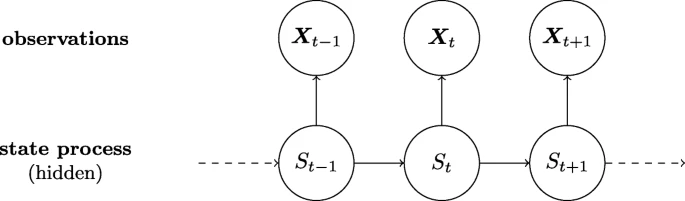

In [28]:
Image(filename='src/HMM.png')

A more classical approach to market regime clustering involves fitting a hidden Markov model (HMM) to observed time series data.

We assume that there exist k ∈ N hidden latent states {1, . . . , k} which govern the dynamics of process (X).

The transition between the latent states is assumed Markovian, and although they are not directly observable they are represented by a transition density
$f (x | z_l, θ_l)$ where $z_l$ is the given latent state and $θ_l$ are parameters associated to the state, for $l = 1, . . . , k$, and the most common choice of likelihood is a Gaussian one. 

We will take an observation window of one week (35 returns) with a step of 7 :

* First oberservation : observation at $t_{42}$ : [$R (t_{6}, t_{7}) , R (t_{7}, t_{8}) ....... R (t_{40}, t_{41}) $]
* Second oberservation : observation at $t_{49}$ : [$R (t_{13}, t_{14}) , R (t_{14}, t_{15}) ....... R (t_{47}, t_{48}) $]
* ........................

In [29]:
h1 = 35
h2 = 7

_, lift = partition(stream, h1, h2, return_lift=True)
features_hmm = lift

features_hmm

,r_1,r_2,r_3,r_4,r_5,r_6,r_7,r_8,r_9,r_10,...,r_26,r_27,r_28,r_29,r_30,r_31,r_32,r_33,r_34,r_35
42,0.008780,-0.000066,-0.005853,0.005644,0.000776,-0.007579,0.004994,0.000600,0.002873,0.004187,...,-0.001430,-0.001157,-0.001417,0.001884,0.006646,-0.000166,-0.002100,0.001396,-0.000075,0.003541
49,0.000600,0.002873,0.004187,-0.001512,0.005197,-0.005736,0.001372,-0.003112,0.001570,0.003874,...,0.001396,-0.000075,0.003541,0.006551,0.010391,0.004356,-0.002437,-0.001781,0.002215,-0.000806
56,-0.003112,0.001570,0.003874,0.004924,0.001661,0.003502,-0.002429,0.005475,0.002404,0.000796,...,-0.001781,0.002215,-0.000806,-0.001574,0.002608,0.006185,-0.001020,0.003683,-0.004169,0.001610
63,0.005475,0.002404,0.000796,-0.001600,-0.001430,-0.001157,-0.001417,0.001884,0.006646,-0.000166,...,0.003683,-0.004169,0.001610,0.003995,-0.003442,-0.005834,0.003087,-0.005423,0.001926,0.000655
70,0.001884,0.006646,-0.000166,-0.002100,0.001396,-0.000075,0.003541,0.006551,0.010391,0.004356,...,-0.005423,0.001926,0.000655,-0.003925,-0.001181,0.006882,-0.000204,0.002258,0.003486,-0.007253
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
35245,-0.010462,0.007319,0.002457,0.001672,0.004693,0.000454,-0.006406,0.001927,0.007028,-0.003460,...,0.003868,0.005655,0.004768,0.000283,0.008605,-0.000078,-0.002586,-0.003745,-0.003572,0.001174
35252,0.001927,0.007028,-0.003460,0.002597,0.001810,0.006248,-0.005474,0.002787,0.008577,0.000453,...,-0.003745,-0.003572,0.001174,0.002635,0.001044,0.001077,-0.000499,0.005076,-0.009025,-0.007934
35259,0.002787,0.008577,0.000453,0.000694,0.000391,-0.002401,-0.004770,0.001343,-0.009677,-0.004507,...,0.005076,-0.009025,-0.007934,0.003859,0.003200,-0.002822,0.005762,-0.004213,-0.003022,0.001092
35266,0.001343,-0.009677,-0.004507,0.009217,0.003868,0.005655,0.004768,0.000283,0.008605,-0.000078,...,-0.004213,-0.003022,0.001092,0.009180,-0.002782,-0.002226,0.009399,0.001654,0.000885,-0.005809


In [30]:
estimator_hmm = model_hmm = GaussianHMM(
                                        n_components=2,                     # number of states
                                        covariance_type="full",             # full covariance matrix vs diagonal
                                        n_iter=5000 ,random_state=2022,
                                    # number of iterations
                                    )
estimator_hmm.fit(features_hmm)

GaussianHMM(covariance_type='full', n_components=2, n_iter=5000,
            random_state=2022)

In [31]:
labels_hmm = create_labels(estimator_hmm, features_hmm)
labels_hmm = labels_hmm.replace(0,-1).replace(1,0).replace(-1,1)

In [32]:
fig = plot_regime_time_series(labels_hmm, index_data, return_fig=True)
for d in regime_dates:
    fig.add_vrect(x0=d, x1=d+regime_duration)
fig.show()

We compute the accuracy of the MK means :

In [33]:
(y_truth.loc[labels_hmm.index] == labels_hmm).mean()

0.9731823599523242

We compute the V-measure of the MK means :

 **v = (1 + beta) * homogeneity * completeness / (beta * homogeneity + completeness)**

* Completeness :
    A clustering result satisfies completeness if all the data points that are members of a given class are elements of the same cluster.

* homogeneity : 
    A clustering result satisfies homogeneity if all of its clusters contain only data points which are members of a single class.

In [34]:
v_measure_score(y_truth[labels_hmm.index], labels_hmm)

0.7818362000251161

To have another view on the clustering, we plot each set of returns in the mean/vol space :

In [35]:
#Here, each centroid represents reprsent the mean and volatitly of each hidden state.

mean_volatility_plot(lift,labels_hmm, estimator_hmm.means_,
                     np.array(estimator_hmm.means_).mean(axis=1),
                    [np.diag(np.sqrt(estimator_hmm.covars_[0])).mean(), np.diag(np.sqrt(estimator_hmm.covars_[1])).mean()])

### At first glance, the HMM looks to be good in detecting regime changes (still worst than than WK-means). However, if you try and change the random state, the results would be very different.

# 2.4 Test of Random State stability

To be more precise, we do another test in which we vary the random state :

In [36]:
def evaluate_clustering(features, estimator, random_state, n_trials, vol, y_truth, ):
    
    results = pd.DataFrame(columns=['Overall', 'Regime ON', 'Regime OFF'])
    for trial in range(n_trials):
        estimator.set_params(**{'random_state':prng.random_integers(3000)})
        estimator = estimator.fit(features)
        labels = create_labels(estimator, features)
        
        if vol[labels==0].mean() > vol[labels==1].mean():
            labels = labels.replace(0,-1).replace(1,0).replace(-1,1)
            
        y_truth = y_truth[labels.index]
            
        results = results.append(pd.Series([(y_truth==labels).mean(),
                       (y_truth[y_truth==1] == labels[y_truth==1] ).mean(),
                       (y_truth[y_truth==0] == labels[y_truth==0] ).mean()], index=results.columns), ignore_index=True)
        
    return results

In [37]:
prng = np.random.RandomState(42)
results_hmm = evaluate_clustering(features_hmm, estimator_hmm, prng, 10, moments.moment_2, y_truth)

prng = np.random.RandomState(42)
results_mk_means = evaluate_clustering(features_mk_means, estimator_mk_means, prng, 10, moments.moment_2, y_truth)

prng = np.random.RandomState(42)
results_wk_means = evaluate_clustering(features_wk_means, estimator_wk_means, prng, 10, moments.moment_2, y_truth)

Even though the 'startprob_' attribute is set, it will be overwritten during initialization because 'init_params' contains 's'
Even though the 'transmat_' attribute is set, it will be overwritten during initialization because 'init_params' contains 't'
Even though the 'means_' attribute is set, it will be overwritten during initialization because 'init_params' contains 'm'
Even though the 'covars_' attribute is set, it will be overwritten during initialization because 'init_params' contains 'c'
Even though the 'startprob_' attribute is set, it will be overwritten during initialization because 'init_params' contains 's'
Even though the 'transmat_' attribute is set, it will be overwritten during initialization because 'init_params' contains 't'
Even though the 'means_' attribute is set, it will be overwritten during initialization because 'init_params' contains 'm'
Even though the 'covars_' attribute is set, it will be overwritten during initialization because 'init_params' contains 'c'


In [38]:
results_hmm.mean()

Overall       0.833393
Regime ON     0.199509
Regime OFF    0.994271
dtype: float64

The HMM model fails to recongnize both regimes. Its regime OFF accuracy is hight because the algorithm places all its predictions on the regime OFF class.

In [39]:
results_hmm

,Overall,Regime ON,Regime OFF
0,0.797576,0.009814,0.997509
1,0.799563,0.009814,1.000000
2,0.798371,0.003925,1.000000
3,0.798768,0.005888,1.000000
4,0.798768,0.005888,1.000000
5,0.973182,0.975466,0.972603
6,0.973182,0.975466,0.972603
7,0.798371,0.003925,1.000000
8,0.798172,0.002944,1.000000
9,0.797974,0.001963,1.000000


Even in times when the Random initialization gives the HMM an edge, its results are still lower that the WK means. Also, this is most likely due to chance, given the number of times this happens (2 out of 10).

In [40]:
results_mk_means.mean()

Overall       0.800556
Regime ON     0.014720
Regime OFF    1.000000
dtype: float64

The moments K means does not have the same issue, however it's accuracy is not very great.

In [41]:
results_wk_means.mean()

Overall       0.990842
Regime ON     0.965554
Regime OFF    0.997260
dtype: float64

The WK means is most accurate and stable model

# 2.5 MMD 

In [42]:
Image("data/img/MMD.png")

FileNotFoundError: No such file or directory: 'data/img/MMD.png'

FileNotFoundError: No such file or directory: 'data/img/MMD.png'

<IPython.core.display.Image object>

Another method to campare clustering algirthm is MMD.

Maximum Mean Discrepancy (MMD), is used to confirm the goodness-of-fit of clustered market regimes. 

The MMD has been shown to be a robust estimator under both dependence and presence of outliers and has been employed frequently in the quantitative finance and machine learning literature.

<hr />

We sample, 1000 pairs that are the same cluster and compute MMD² between each pair. We plot then the empricial distribution of MMD².

Ideally, we want the distribution of MMD² to be very tight and close to zero. As a matter of fact, if the observations are in the same cluster, we would expect their MMD² to be low. 

PS: MMD² can be nagtive as we use a biased estimator of MMD².

In [43]:
mmd_wk_0 = compute_mmd(lift, labels_wk_means, 1000, [0], random_state=2021)
mmd_wk_1 = compute_mmd(lift, labels_wk_means, 1000, [1], random_state=2021)

mmd_mk_0 = compute_mmd(lift, labels_mk_means, 1000,[0], random_state=2021)
mmd_mk_1 = compute_mmd(lift, labels_mk_means, 1000, [1], random_state=2021)

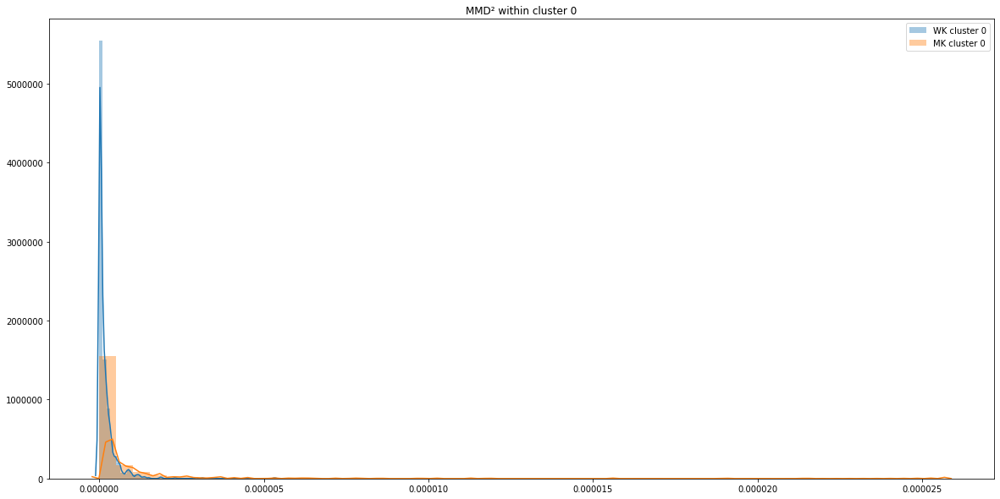

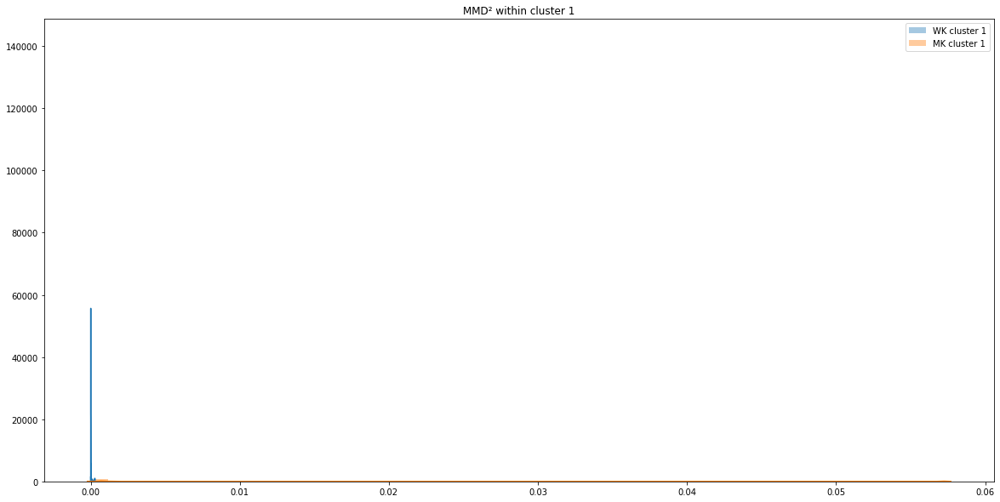

In [44]:
plot_type = 'sns' #plotly

if plot_type == 'sns':
    sns.distplot(mmd_wk_0, hist=True, label='WK cluster 0')
    sns.distplot(mmd_mk_0, hist=True, label='MK cluster 0')
    plt.title('MMD² within cluster 0')
    plt.legend()
    plt.show()
    
    sns.distplot(mmd_wk_1, hist=True, label='WK cluster 1')
    sns.distplot(mmd_mk_1, hist=True, label='MK cluster 1')
    plt.title('MMD² within cluster 1')
    plt.legend()
    plt.show()

elif plot_type == 'plotly':
    hist_data = [mmd_wk_0, mmd_mk_0]
    group_labels = ['WK cluster 0', 'MK cluster 0',]
    fig = ff.create_distplot(hist_data, group_labels, bin_size=1e-6)
    fig.show()

    hist_data = [mmd_wk_1, mmd_mk_1]
    group_labels = ['WK cluster 1', 'MK cluster 1',]
    fig = ff.create_distplot(hist_data, group_labels, bin_size=1e-6)
    fig.show()